# End-to-end Multi-class Dog Breed Identifation Project

The notebook is an attempt to create an end-to-end multi-class image classifier using TensorFlow 2.0 and Tensorflow Hub.

## Problem Definition 

Given an image of a dog, identifying the breed of the dog.

## Data

The data used in this project is from Kaggle's dog breed identification competition.
https://www.kaggle.com/competitions/dog-breed-identification/data

## Evaluation

File with prediction probabilities for each dog breed of each test image.
https://www.kaggle.com/competitions/dog-breed-identification/overview/evaluation

## Features

* The data consists of images of dogs, i.e. unstructured data.
* 120 breeds of dogs in total, i.e. 120 different classes
* 10,000+ images in both training and testing datasets 



In [202]:
!unzip "drive/MyDrive/Dog-Breed-Identification/dog-breed-identification.zip" -d "drive/MyDrive/Dog-Breed-Identification"

Streaming output truncated to the last 5000 lines.
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83bc62b0fffa99a9c94ba0b67a5f7395.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83bcff6b55ee179a7c123fa6103c377a.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83be6d622ab74a5e7e08b53eb8fd566a.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83c2d7419b0429b9fe953bc1b6cddbec.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83cf7d7cd2a759a93e2ffd95bea9c6fb.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83d405858f0931722ef21e8ac0adee4d.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83d4125a4c3c7dc5956563276cb1cd74.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83f0bb565b2186dbcc6a9d009cb26ff2.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83fad0718581a696132c96c166472627.jpg  
  inflating: drive/MyDrive/Dog-Breed-Identification/train/83fbbcc9a612e3f712

### Creating the Workspace

In [203]:
# importing Tensorflow into colab
import tensorflow as tf
import tensorflow_hub as hub
print("TF version:", tf.__version__)
print("TF Hub version:", hub.__version__)

#checking the availability of GPU
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available")

TF version: 2.12.0
TF Hub version: 0.13.0
GPU available


### Turning data into tensors


In [204]:
#checking the labels of the data
import pandas as pd

labels = pd.read_csv("drive/My Drive/Dog-Breed-Identification/labels.csv")
print(labels.describe())
print(labels.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [205]:
#Dogs corresponding to each breed
dog_labels = labels["breed"].value_counts()
dog_labels

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
golden_retriever         67
brabancon_griffon        67
komondor                 67
eskimo_dog               66
briard                   66
Name: breed, Length: 120, dtype: int64

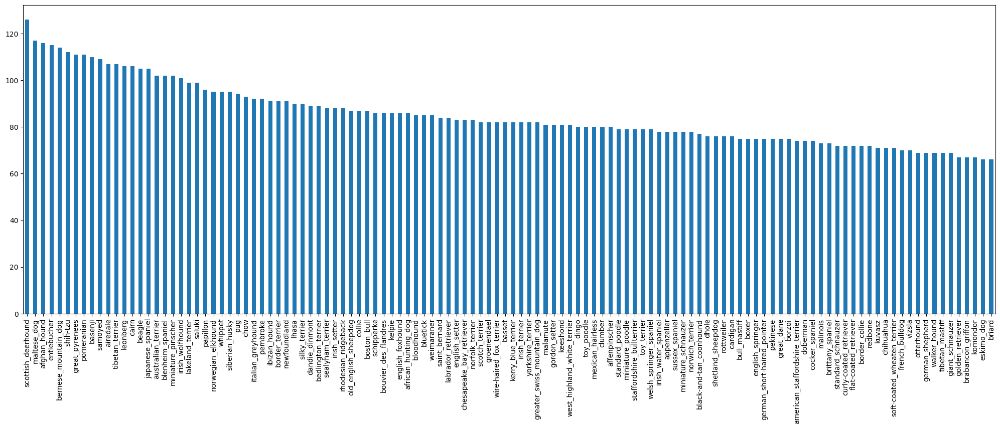

In [206]:
dog_labels.plot.bar(figsize=(25, 8));

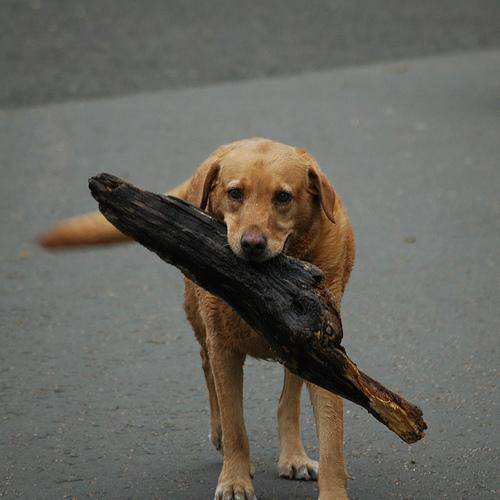

In [207]:
#trying to dispaly an image
from IPython.display import Image
Image("drive/My Drive/Dog-Breed-Identification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg")

### Creating pathnames for all images

In [208]:
fileNames  = ["drive/My Drive/Dog-Breed-Identification/train/"+ fname for fname in labels["id"] +".jpg"]
fileNames[:10]

['drive/My Drive/Dog-Breed-Identification/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Dog-Breed-Identification/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [209]:
#cross check the list length and number of images
import os
if len(os.listdir("drive/My Drive/Dog-Breed-Identification/train/")) == len(fileNames) :
  print("All set")
else:
  print("fileNames do not match with the number of images")

All set


### Preparing the labels

In [210]:
import numpy as np
labels_arr = labels["breed"]
labels_arr = np.array(labels_arr)
labels_arr

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [211]:
#cross check the length of labels_arr and number of images

if len(labels_arr) == len(fileNames) :
  print("All set")
else:
  print("labels array length do not match with the number of images")

All set


In [212]:
#unique breeds
unique_breeds = np.unique(labels_arr)
(unique_breeds, len(unique_breeds))

(array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
        'american_staffordshire_terrier', 'appenzeller',
        'australian_terrier', 'basenji', 'basset', 'beagle',
        'bedlington_terrier', 'bernese_mountain_dog',
        'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
        'bluetick', 'border_collie', 'border_terrier', 'borzoi',
        'boston_bull', 'bouvier_des_flandres', 'boxer',
        'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
        'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
        'chow', 'clumber', 'cocker_spaniel', 'collie',
        'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
        'doberman', 'english_foxhound', 'english_setter',
        'english_springer', 'entlebucher', 'eskimo_dog',
        'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
        'german_short-haired_pointer', 'giant_schnauzer',
        'golden_retriever', 'gordon_setter', 'gre

In [213]:
#boolean array for each breed
bool_labels = [breed == unique_breeds for breed in labels_arr]
bool_labels[:2] 

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [214]:
#boolean into integers
print(labels_arr[0])
print(bool_labels[0].astype(int))

boston_bull
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating a Validation set

In [215]:
X = fileNames
y = bool_labels

In [216]:
#choosing the number of images
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}

In [217]:
#splitting train dataset into train and validation sets
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], y[:NUM_IMAGES],
                                                  test_size=0.2, random_state=73)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

### Images to Tensors

Following function does the job of preprocessing images into tensors. It works in the following way:

* Takes input that is an image filepath
* Reads and saves the image file to a variable, `image` using Tensorflow
* Turns the `image` (a jpg file) into tensor
* Resize the `image`, so that all image will be of the same shape of (300, 300)
* Returning the modified `image`

In [218]:
#defining a contant image size
IMG_SIZE = 299

def img_to_tensor(path, img_size = IMG_SIZE):
  """
  turns the image into a tensor bu taking file path as input
  """
  #read the image file
  image = tf.io.read_file(path)

  #tunring to numerical tensor with 3 color channels namely RGB
  image = tf.image.decode_jpeg(image, channels=3)

  #normaliztion, that is, converting color channel values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)

  #rezizing the images 
  image = tf.image.resize(image, size=[img_size, img_size])

  return image

### Creating Data Batches

Processing large dataset of images at a time might not fit into memory.
So, creting a batch size of 32 is an ideal way to process the image data set

In [219]:
#following function is to return a tuple (image, label)
def img_label(path, label):
  """
  this function is just to create a tuple of (image, label),
  by taking file path and corrspondinlabel
  """

  image = img_to_tensor(path)
  return image, label

In [220]:
(img_to_tensor(X[71]), tf.constant(y[71]))

(<tf.Tensor: shape=(299, 299, 3), dtype=float32, numpy=
 array([[[0.1183806 , 0.13014531, 0.09485119],
         [0.07900004, 0.09076475, 0.05547063],
         [0.06962988, 0.07605653, 0.04343143],
         ...,
         [0.05926947, 0.07070697, 0.04734116],
         [0.03204719, 0.07116486, 0.03590341],
         [0.03438962, 0.07360531, 0.03831119]],
 
        [[0.10755081, 0.11931551, 0.08402139],
         [0.0920828 , 0.10384751, 0.06855339],
         [0.07648853, 0.08291518, 0.05029009],
         ...,
         [0.067094  , 0.07853151, 0.05471046],
         [0.04078218, 0.07989986, 0.04463841],
         [0.04423761, 0.08345329, 0.04815917]],
 
        [[0.09341873, 0.10518344, 0.06988931],
         [0.1052397 , 0.1170044 , 0.08171028],
         [0.0886963 , 0.09512295, 0.06249785],
         ...,
         [0.07332169, 0.08475921, 0.05872448],
         [0.0495079 , 0.08862557, 0.05336412],
         [0.05949958, 0.09871528, 0.06342115]],
 
        ...,
 
        [[0.25302076, 0.20596194

Following function is to turn all our data (`X`, `y`) into batches as we got our
data into tuples of tensors

In [221]:
#defining the batch size idelly 32
BATCH_SIZE = 32

def to_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  creates batches, shuffles the training data but doesn't shuffle the validation
  data and accepts test data also as input but no labels.
  """

  #for test, validation, and train datasets
  if test_data:
    print("test data batches...processing...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) #no lables
    data_batch = data.map(img_to_tensor).batch(batch_size)
    return data_batch
  
  elif valid_data:
    print("validation data batches...processing...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
    data_batch = data.map(img_label).batch(batch_size)
    return data_batch
  
  else: #train_data
    print("train data batches...processing...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
    
    #shuffling pathNames and labels; before mapping because faster to suffle pathNames and lables than images
    data = data.shuffle(buffer_size=len(X))

    data = data.map(img_label)
    data_batch = data.batch(batch_size)
    return data_batch 

In [222]:
#creating training and validating data batches
train_data = to_batches(X_train, y_train)
val_data = to_batches(X_val, y_val, valid_data=True)

train data batches...processing...
validation data batches...processing...


In [223]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 299, 299, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 299, 299, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

### Visualizing the data batches

In [224]:
import matplotlib.pyplot as plt

#following function is to visualize the images batchwise
def batch_images(images, labels):
  """
  plots the images of a batch
  """

  plt.figure(figsize=(20, 20))

  for i in range(32):
    #create subplots
    ax = plt.subplot(6, 6, i+1)
    #displaying an image
    plt.imshow(images[i])

    #title as corresponding label
    plt.title(unique_breeds[labels[i].argmax()])


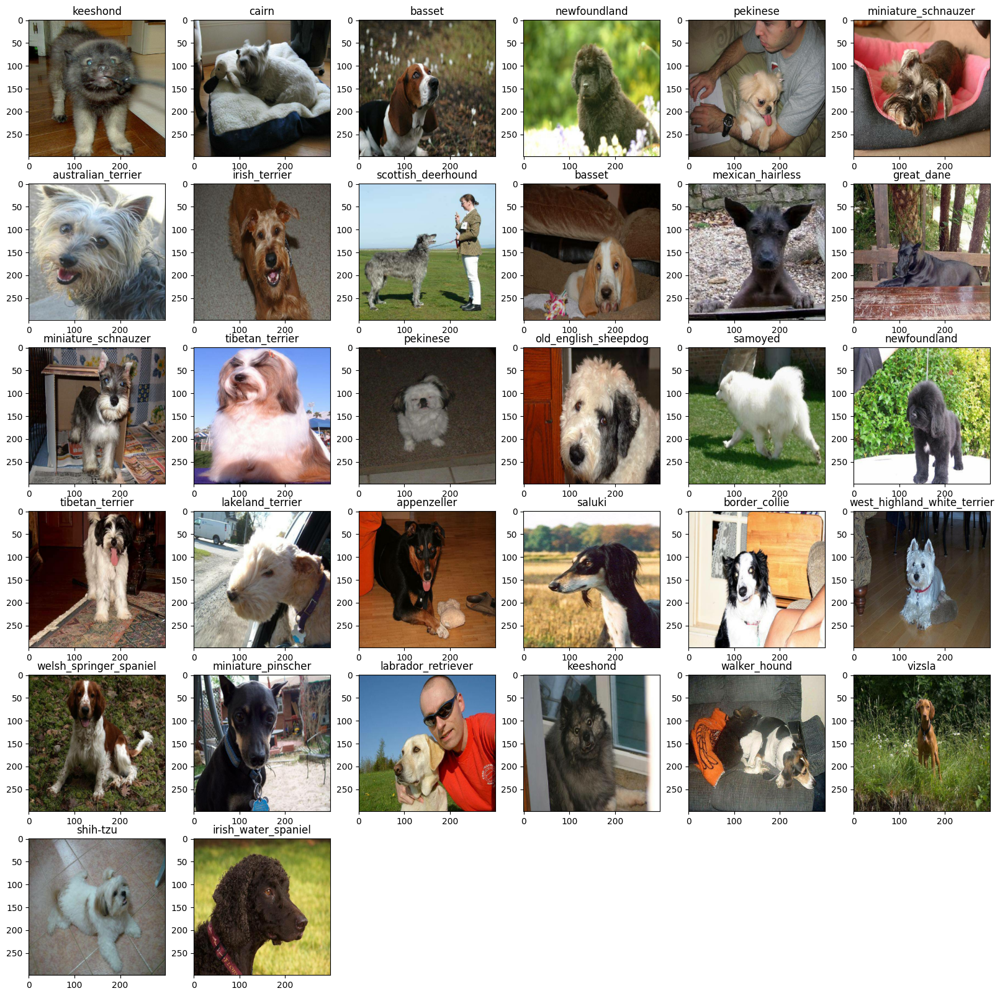

In [225]:
#next points to the batch at the top
train_images, train_labels = next(train_data.as_numpy_iterator())
batch_images(train_images, train_labels)
#images get shuffled everytime

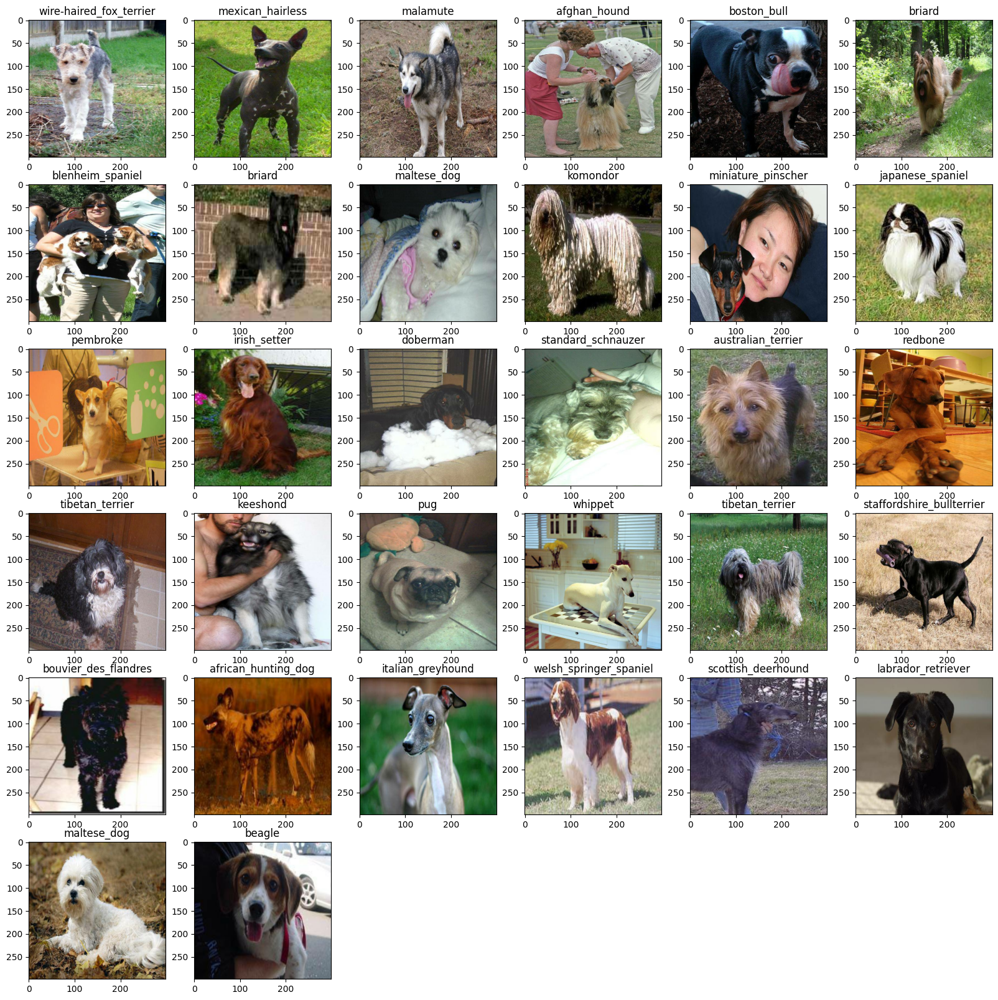

In [226]:
#similarly for a validation set
val_images, val_labels = next(val_data.as_numpy_iterator())
batch_images(val_images, val_labels)
#images don't get shuffled

### Building the model

URL used is of the model imagenet/inception_v3/classification.

https://tfhub.dev/google/imagenet/inception_v3/classification/5

In [227]:
#setting up the input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] 
              #batch  #height   #width #colorchannels

#setting up output shape of the model
OUTPUT_SHAPE = len(unique_breeds) #image labels are the output

#settingup the model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/inception_v3/classification/5"

### Keras Deep leraning model

The following function:
* Takes the input shape, output shape and the model as parameters.
* Defines the layers in sequential way in the Keras model.
* Compiles the model, that is, tells us about the evaluation or improvization
* Builds the model.
* Return the model.

In [228]:
def build_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url = MODEL_URL):
  print("Building model with:", model_url)

  #setting up model layers in a sequential manner
  model = tf.keras.Sequential([
      hub.KerasLayer(model_url), #input layer
      tf.keras.layers.Dense(units=output_shape,
                            activation="softmax") #output layer
  ])

  #compiling the model
  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(),
      optimizer = tf.keras.optimizers.Adam(),
      metrics = ["accuracy"]
  )

  #building the model
  model.build(input_shape)

  return model

In [229]:
model = build_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/inception_v3/classification/5
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_9 (KerasLayer)  (None, 1001)              23853833  
                                                                 
 dense_9 (Dense)             (None, 120)               120240    
                                                                 
Total params: 23,974,073
Trainable params: 120,240
Non-trainable params: 23,853,833
_________________________________________________________________


### Creating Callbacks

Model uses callback functions to save its progress, check progress and stop if the model is not improving.

* TensorBoard call back function tracks the model progress.
* Another callback function for early stop and prevent the model from training for too long.

### TensorBoard Callback

* Loading the TensorBoard notebook extension.
* Creating a TensoBoard callback which saves logs to a directory and pass it the fit function.
* Visualizing the training logs.

In [230]:
#loading the tensorboard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [231]:
import datetime

#creating callback

def tensorboard_callback():
  #directory to store logs
  log_dir = os.path.join("drive/My Drive/Dog-Breed-Identification/logs",
                         datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(log_dir)

### Early stopping CallBack

Prevents from overfitting.

In [232]:
stop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy", patience=3)

### Training the model on a subset of data

Training on a subset of data of size 1000 to cross check.

In [233]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

Making sure we are using a GPU

In [234]:
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available")

GPU available


Now, the following function trains model by following the steps:
* Building a model using `build_model()` function.
* Creating a TensorBoard callback using `tensorboard_callback()` function.
* Calling the fit function to train for the `NUM_EPOCHS` and the callbacks by passing it the training and validation data along with the number of NUM_EPOCHS
* Returning the model

In [235]:
def train_model():
  """
  Trains the model and returns the trained model
  """
  #build model
  model = build_model()

  #New TensorBoard callback as we have created for stop_callback only once
  tensorboard = tensorboard_callback()

  #fit the model
  model.fit(x=train_data, epochs=NUM_EPOCHS, validation_data=val_data,
            validation_freq=1, callbacks=[tensorboard, stop_callback])
  
  return model


In [236]:
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/inception_v3/classification/5
Epoch 1/100
25/25 [==============================] - 20s 436ms/step - loss: 4.0589 - accuracy: 0.2013 - val_loss: 2.6451 - val_accuracy: 0.4800
Epoch 2/100
25/25 [==============================] - 4s 159ms/step - loss: 1.2861 - accuracy: 0.8138 - val_loss: 1.1437 - val_accuracy: 0.8100
Epoch 3/100
25/25 [==============================] - 4s 162ms/step - loss: 0.4147 - accuracy: 0.9475 - val_loss: 0.7468 - val_accuracy: 0.8350
Epoch 4/100
25/25 [==============================] - 5s 195ms/step - loss: 0.1998 - accuracy: 0.9850 - val_loss: 0.6110 - val_accuracy: 0.8650
Epoch 5/100
25/25 [==============================] - 5s 194ms/step - loss: 0.1286 - accuracy: 0.9887 - val_loss: 0.5746 - val_accuracy: 0.8550
Epoch 6/100
25/25 [==============================] - 4s 171ms/step - loss: 0.0933 - accuracy: 0.9950 - val_loss: 0.5369 - val_accuracy: 0.8600
Epoch 7/100
25/25 [==============================] - 5s 

### Checking the TensorBoard logs

In [237]:
%tensorboard --logdir drive/My\ Drive/Dog-Breed-Identification/logs --port=6007

Reusing TensorBoard on port 6007 (pid 26706), started 0:28:25 ago. (Use '!kill 26706' to kill it.)

<IPython.core.display.Javascript object>

### Making Predictions and evaluating predictions using the trained model

In [238]:
#on the validation data
preds = model.predict(val_data, verbose=1)
preds

7/7 [==============================] - 3s 140ms/step


array([[4.0884675e-05, 3.7988419e-05, 1.2262676e-05, ..., 2.6413964e-04,
        8.9806628e-01, 2.5131738e-05],
       [9.0351881e-04, 8.0227153e-05, 2.7218621e-04, ..., 2.4305058e-03,
        9.8051105e-06, 8.7283639e-05],
       [5.8995640e-05, 3.1487262e-04, 3.3947628e-03, ..., 4.6884842e-04,
        7.7574095e-04, 1.0851814e-03],
       ...,
       [7.4862171e-04, 1.8046969e-04, 4.6985381e-04, ..., 7.9723506e-04,
        7.7218551e-04, 1.8552532e-04],
       [9.0861775e-04, 7.6356274e-04, 6.4205873e-04, ..., 2.5346106e-02,
        1.4135271e-04, 1.4217802e-03],
       [3.0910516e-05, 2.2326882e-05, 3.9602550e-05, ..., 1.4569012e-04,
        2.9985583e-04, 1.3871587e-04]], dtype=float32)

In [239]:
preds.shape

(200, 120)

200 y_values and 120 is the len of each y value

Following function is to print out the prediction values and labels by taking the index as input.

In [240]:
def print_pred(index):
  """
  prints the maximum value among all the probabilites, corresponding index and breed name
  """
  print(preds[index])
  print(f"Max value (probability of prediction) : {np.max(preds[index])}")
  print(f"Sum : {np.sum(preds[index])}")
  print(f"Max Index : {np.argmax(preds[index])}")
  print(f"Predicted Breed : {unique_breeds[np.argmax(preds[index])]}")
  

In [241]:
print_pred(71)

[1.53584231e-04 5.73803809e-05 4.64461345e-06 1.27132502e-04
 2.47445349e-02 5.85813657e-04 8.74257385e-05 6.72887312e-04
 1.19073457e-05 1.10224704e-04 1.12082334e-05 3.84692294e-06
 5.59920773e-05 1.09223402e-04 5.23142371e-05 2.56853173e-06
 8.66469509e-06 6.91034074e-05 9.34295144e-07 8.11387654e-05
 1.34870454e-04 1.29081786e-03 9.10584058e-05 3.92122020e-05
 1.49906236e-05 1.10248523e-03 1.10181194e-04 1.68633505e-05
 4.66214115e-04 3.76892101e-04 3.86681291e-04 2.63400161e-05
 2.10556427e-05 8.18582484e-05 1.01505328e-04 4.47471803e-06
 2.87639814e-05 2.32878756e-05 5.37627193e-06 1.67940507e-05
 5.66086419e-06 4.15453951e-06 1.68901333e-05 4.38750023e-04
 1.84723103e-05 2.19441117e-05 2.11693100e-06 4.40051963e-06
 3.99026476e-06 1.54449954e-04 1.28340071e-06 9.55776159e-06
 1.92439547e-05 7.73176362e-05 9.98656560e-06 2.41503926e-06
 3.11511176e-05 3.02421977e-04 6.07175862e-05 3.02648295e-05
 9.26938665e-05 1.97191839e-05 5.48298885e-06 1.01671190e-04
 2.70627552e-05 3.712703

Another simple function to return the breed name by taking the prediction probabilities as input

In [242]:
def pred_breed(pred_probs):
  """
  Returns the breed name by taking prdiction probabilities as input
  """
  return unique_breeds[np.argmax(pred_probs)]

In [243]:
predicted_breed = pred_breed(preds[63])
predicted_breed

'bouvier_des_flandres'

Next, to make predictions on validation images and compare those to the validation labels, we have to unbatch the the batch datasets.

In [244]:
#function to unbatch
def unbatch_data(data):
  """
  takes data with in batches and returns the seperate arrays of images and labels
  """
  images = []
  labels = []

  #iterating over unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

In [245]:
val_images, val_labels = unbatch_data(val_data)
val_images[0], val_labels[0]

(array([[[0.42927855, 0.47633737, 0.53908247],
         [0.50476754, 0.55182636, 0.6100859 ],
         [0.48737624, 0.5344351 , 0.58933705],
         ...,
         [0.00784314, 0.03137255, 0.08627451],
         [0.00784314, 0.03137255, 0.08627451],
         [0.00784314, 0.03137255, 0.08627451]],
 
        [[0.4353338 , 0.4823926 , 0.53729457],
         [0.5086891 , 0.5557479 , 0.6106499 ],
         [0.48382193, 0.53088075, 0.5857827 ],
         ...,
         [0.00784314, 0.03137255, 0.08627451],
         [0.00784314, 0.03137255, 0.08627451],
         [0.00784314, 0.03137255, 0.08627451]],
 
        [[0.4433105 , 0.49036932, 0.5452713 ],
         [0.5098317 , 0.55689055, 0.6087396 ],
         [0.48127785, 0.52833664, 0.5779006 ],
         ...,
         [0.00784314, 0.03137255, 0.08627451],
         [0.00784314, 0.03137255, 0.08627451],
         [0.00784314, 0.03137255, 0.08627451]],
 
        ...,
 
        [[0.07055958, 0.11907388, 0.120354  ],
         [0.07361256, 0.11056579, 0.10440

In [246]:
#compare
(pred_breed(val_labels[0]), pred_breed(preds[0]))

('affenpinscher', 'wire-haired_fox_terrier')

Let's visualize things in a better way from the data we are having:
* Prediction labels
* Validation labels (truth labels)
* Validation images

The following function ,

* Takes an array of prediction probabilities, another array of truth labels and an array of images and integer as input.
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, its predicted probability, the truth label and the target image on a single plot.

In [247]:
def pred_plot (pred_probs, labels, images, n):

  pred_probs, true_label, image = pred_probs[n], labels[n], images[n]

  #getting the prediction label
  pred_label = pred_breed(pred_probs)

  #plot image
  plt.imshow(image)

  #remove ticks
  plt.xticks([])
  plt.yticks([])

  #title color green or red based on validity of prediction
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  #title for the plot
  plt.title("{} {:2.0f}% {}".format(pred_label,
                                    np.max(pred_probs)*100,
                                    true_label),
            color = color)

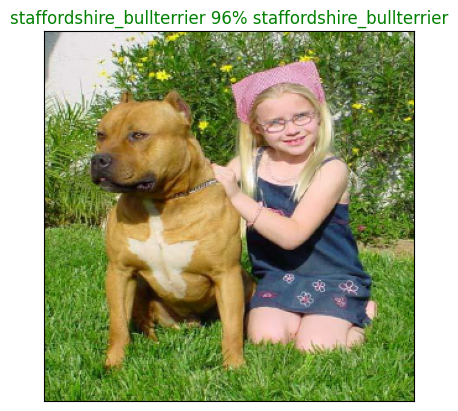

In [248]:
pred_plot(pred_probs=preds,
          labels=val_labels,
          images=val_images,
          n=71)

The following function is to visualize the top 10 predictions made by the model.

The function will:
* Take an array of prediction probabilities, another array of truth labels and an array of integer as input.
* Convert the prediction probabilities to a predicted label.
* Find top 10 predictions of a image:
  - Prediction probabilities indexes
  - Prediction probabilities values
  - prediction labels
* Plot the top 10 prediction prabability values, labels and image.

In [249]:
def plot_10_preds(pred_probs, labels, n):

  pred_probs, true_label = pred_probs[n], labels[n]

  #getting the prediction label
  pred_label = pred_breed(pred_probs)

  #top 10 prediction confidence indexes
  top_10_indexes = pred_probs.argsort()[-10:][::-1]
  #top 10 prediction confidence values
  top_10_values = pred_probs[top_10_indexes]
  #top 10 prediction confidence labels
  top_10_labels = unique_breeds[top_10_indexes]

  #setup plot
  top_10_plot = plt.bar(np.arange(len(top_10_labels)),
                        top_10_values,
                        color="darksalmon")
  
  plt.xticks(np.arange(len(top_10_labels)),
             labels = top_10_labels,
             rotation = "vertical")


  #color based on validity of prediction
  if np.isin(true_label, top_10_labels):
    top_10_plot[np.argmax(top_10_labels == true_label)].set_color("green")
  else:
    pass

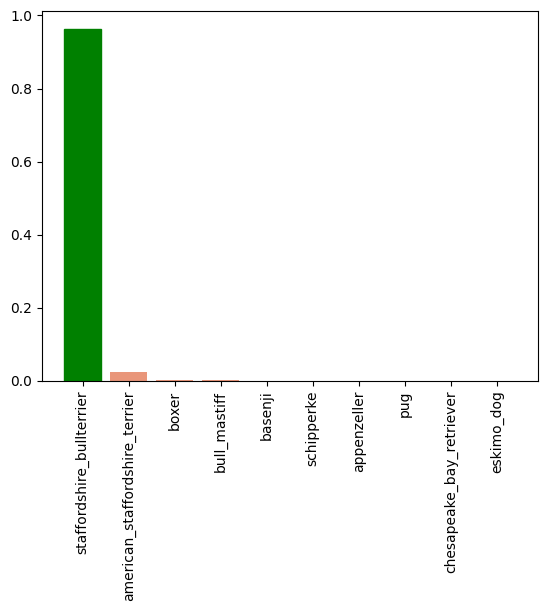

In [250]:
plot_10_preds(pred_probs = preds,
              labels = val_labels,
              n=71)

Now, let's evluate the model by checking the visulization using the function written above.

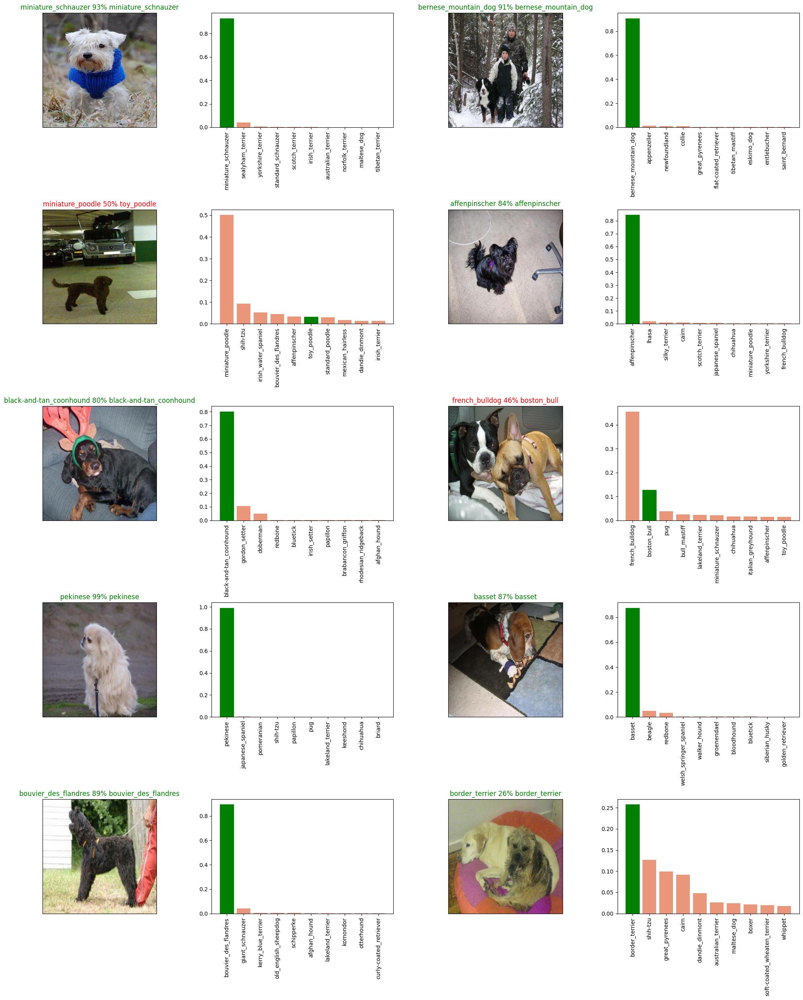

In [251]:
#let's check out few visualizations

i_multiplier = 50
nrows = 5
ncols = 2
nimages = nrows*ncols

plt.figure(figsize=(10*ncols, 5*nrows))

for i in range(nimages):
  plt.subplot(nrows, 2*ncols, 2*i+1)
  pred_plot(pred_probs = preds,
            labels=val_labels,
            images = val_images,
            n = i+i_multiplier)
  plt.subplot(nrows, 2*ncols, 2*i+2)
  plot_10_preds(pred_probs = preds,
            labels=val_labels,
            n = i+i_multiplier)
plt.tight_layout()
plt.show()

Now, let's create a confusion matrix with the models predictions and true labels

In [252]:
#import confusion_matrix from sklearn.metrics
from sklearn.metrics import confusion_matrix

# Prepare true labels and predicted labels
true_labels = val_labels # True labels for test images
predicted_labels = []  # Predicted labels by the model

#iterating over validation data to create a list of predicted labels
for i in range(len(val_labels)):
  predicted_labels.append(pred_breed(preds[i]))

# Create the confusion matrix
confusion_mat = confusion_matrix(true_labels, predicted_labels)

#print confusion matrix
print(confusion_mat)


[[1 0 0 ... 0 0 0]
 [0 2 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 3]]


### Saving and loading the model

In [253]:
#creating afunction to save a model

def save_model(model, suffix=None):
  """
  this function save the model in the models directory and appends a suffix
  """
  #create a model directory
  model_dir = os.path.join("drive/My Drive/Dog-Breed-Identification/models",
                           datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  
  model_path = model_dir + "-" + suffix + ".h5" #save format of the model

  print(f"Saving the model to: {model_path}...")
  model.save(model_path)
  print(f"Saved the model to: {model_path}")

  return model_path

In [254]:
#creating afunctuon to load a saved model

def load_model(model_path):
  """
  Loads a saved model from model directory
  """
  print(f"Loading the model from: {model_path}")

  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  print(f"Loaded the model from: {model_path}")
  
  return model

Let's try saving and reloading the model.

In [255]:
#save the model that we trained on 1000 images
save_model(model, suffix="1000-images-inceptionv3-Adam")

Saving the model to: drive/My Drive/Dog-Breed-Identification/models/20230602-19571685735849-1000-images-inceptionv3-Adam.h5...
Saved the model to: drive/My Drive/Dog-Breed-Identification/models/20230602-19571685735849-1000-images-inceptionv3-Adam.h5


'drive/My Drive/Dog-Breed-Identification/models/20230602-19571685735849-1000-images-inceptionv3-Adam.h5'

In [256]:
#load a trained model 
loaded_1000img_model = load_model("drive/MyDrive/Dog-Breed-Identification/models/20230602-14391685716763-1000-images-inceptionv3-Adam.h5")


Loading the model from: drive/MyDrive/Dog-Breed-Identification/models/20230602-14391685716763-1000-images-inceptionv3-Adam.h5
Loaded the model from: drive/MyDrive/Dog-Breed-Identification/models/20230602-14391685716763-1000-images-inceptionv3-Adam.h5


In [257]:
#let's cross check if the loaded model is performing same as the saved model by evaluating both models

(model.evaluate(val_data), loaded_1000img_model.evaluate(val_data))

7/7 [==============================] - 3s 172ms/step - loss: 0.5223 - accuracy: 0.8500


([0.5227484703063965, 0.8600000143051147],
 [0.5222949385643005, 0.8500000238418579])

The Presaved model and Loaded model performed the same. So, we can now, move to train the model on full dataset.

## Training the model on the full dataset.

In [258]:
len(X), len(y)

(10222, 10222)

In [259]:
#creating data batches from the full data set
full_data = to_batches(X, y)

train data batches...processing...


In [260]:
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 299, 299, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [261]:
#creating the model for full dataset
full_model = build_model()

Building model with: https://tfhub.dev/google/imagenet/inception_v3/classification/5


In [262]:
#full model callbacks
tensorboard_callback_full = tensorboard_callback()

#as we are training on full data, we dont look for validation accuracy
stop_callback_full = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                     patience=2)

**Note:**

Running the cell below takes time, as the GPU should load all the images into teh memory

In [263]:
#fitting the full model to full data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[tensorboard_callback_full, stop_callback_full])

Epoch 1/100
320/320 [==============================] - 56s 149ms/step - loss: 0.8444 - accuracy: 0.8068
Epoch 2/100
320/320 [==============================] - 48s 150ms/step - loss: 0.2242 - accuracy: 0.9296
Epoch 3/100
320/320 [==============================] - 47s 146ms/step - loss: 0.1486 - accuracy: 0.9539
Epoch 4/100
320/320 [==============================] - 46s 144ms/step - loss: 0.1059 - accuracy: 0.9677
Epoch 5/100
320/320 [==============================] - 59s 185ms/step - loss: 0.0790 - accuracy: 0.9773
Epoch 6/100
320/320 [==============================] - 59s 184ms/step - loss: 0.0618 - accuracy: 0.9828
Epoch 7/100
320/320 [==============================] - 57s 178ms/step - loss: 0.0497 - accuracy: 0.9862
Epoch 8/100
320/320 [==============================] - 55s 173ms/step - loss: 0.0405 - accuracy: 0.9914
Epoch 9/100
320/320 [==============================] - 56s 175ms/step - loss: 0.0347 - accuracy: 0.9928
Epoch 10/100
320/320 [==============================] - 60s 187m

Now, let's save and reaload the full trained model.

In [264]:
save_model(full_model, suffix="full-image-set-inceptionv3-Adam")


Saving the model to: drive/My Drive/Dog-Breed-Identification/models/20230602-20211685737265-full-image-set-inceptionv3-Adam.h5...
Saved the model to: drive/My Drive/Dog-Breed-Identification/models/20230602-20211685737265-full-image-set-inceptionv3-Adam.h5


'drive/My Drive/Dog-Breed-Identification/models/20230602-20211685737265-full-image-set-inceptionv3-Adam.h5'

In [265]:
#load the model
loaded_full_model = load_model("drive/MyDrive/Dog-Breed-Identification/models/20230602-19121685733134-full-image-set-inceptionv3-Adam.h5")

Loading the model from: drive/MyDrive/Dog-Breed-Identification/models/20230602-19121685733134-full-image-set-inceptionv3-Adam.h5
Loaded the model from: drive/MyDrive/Dog-Breed-Identification/models/20230602-19121685733134-full-image-set-inceptionv3-Adam.h5


## Making Predictions on the test dataset

The model we trained was actually trained on images in the form of tensors batches,so, the test data should also be in the same format to get its labels predicted.

To make predictions on the test dataset, we'll:
* get the test image file names.
* create test data batches using the function `to_batches` and setting the test_data parameter to `True` (since the test data doen't have labels)
* make predictions array b y passing the test batches to the `predict()` method called on our model. 

In [272]:
#Load test images file names
test_path ="drive/My Drive/Dog-Breed-Identification/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/My Drive/Dog-Breed-Identification/test/05119632960d53cf29f9409de7694258.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/051c1add9677ef6d143bb2f3f84b0b43.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/051cd7e2894925acccc0afcd9b4dbfe0.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/05240d66709e32c9a6d41ce80f62ce33.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/0533f637900fd6c5a654ee50d3332ac3.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/0536a5378c2bb64f2d458b53994f1b32.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/0537a0ff8ec176736b1b005c08977684.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/054d889adc4050ca15d78e2cd2486d1e.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/054ac219ecd4e281c2cf1b2ee635bb99.jpg',
 'drive/My Drive/Dog-Breed-Identification/test/0551436dc38f714b0444949cd6f46073.jpg']

In [274]:
len(test_filenames) 

10365

In [273]:
#creating test batches
test_data = to_batches(test_filenames, test_data=True)

test data batches...processing...


In [275]:
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 299, 299, 3), dtype=tf.float32, name=None)>

**Note:**

predicting the test data labels will take a long time.

In [276]:
#making predictions on test data batches

test_preds = loaded_full_model.predict(test_data,
                                       verbose=1)

324/324 [==============================] - 60s 186ms/step


Let's save the predictions, numpy array, to a csv file. 

In [278]:
np.savetxt("drive/My Drive/Dog-Breed-Identification/preds_array.csv", test_preds, delimiter=",")

Now, let's load the predictions csv file and cross check the things.

In [280]:
test_preds_loaded = np.loadtxt("drive/My Drive/Dog-Breed-Identification/preds_array.csv", delimiter=",")

In [281]:
test_preds_loaded[:10]

array([[1.69972786e-11, 5.62276527e-12, 7.56358531e-09, ...,
        1.61381932e-11, 1.02296505e-11, 9.17646601e-12],
       [1.70332335e-13, 7.19062032e-11, 1.51731766e-10, ...,
        1.08832214e-12, 2.33855443e-13, 7.66584018e-12],
       [3.39146560e-08, 1.34730058e-07, 4.64345042e-08, ...,
        4.02106001e-04, 4.32905906e-10, 5.10728751e-05],
       ...,
       [5.40707434e-09, 5.15122334e-10, 1.55205015e-14, ...,
        9.95868210e-13, 6.18368204e-11, 2.31382447e-09],
       [3.74924980e-10, 9.12728026e-09, 5.08088105e-09, ...,
        1.38903386e-04, 2.36317022e-10, 6.17359183e-06],
       [8.69745179e-11, 2.62970739e-11, 2.22968172e-10, ...,
        2.07321504e-11, 6.41161915e-11, 1.23583522e-12]])

Now, let's, make the model predictions sturctured by:

* Creating a pandas DataFrame with ID column as well as a column for each dog breed.
* Adding data to the ID column by extracting the test image ID's from their file paths.
* Adding the prediction probabilities to each of the dog bred coloumns of each dog image.
* Export the DataFrame to a CSV file.

In [282]:
#creating dataframe
df = pd.DataFrame(columns=["id"] + list(unique_breeds))
df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [284]:
#getting teh ids from file path names
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
df["id"] = test_ids

In [285]:
df[list(unique_breeds)] = test_preds
df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,05119632960d53cf29f9409de7694258,1.699728e-11,5.622765e-12,7.563585e-09,1.749245e-13,2.985023e-14,2.276718e-11,2.453612e-09,7.551718e-10,3.110328e-10,...,1.177173e-13,6.614003e-11,1.445881e-08,2.161583e-13,1.406348e-10,3.310169e-10,4.352146e-11,1.613819e-11,1.022965e-11,9.176466e-12
1,051c1add9677ef6d143bb2f3f84b0b43,1.703323e-13,7.190620e-11,1.517318e-10,3.082884e-14,1.033797e-11,7.067378e-14,6.907103e-13,6.364800e-12,6.669598e-14,...,1.792609e-12,3.200629e-13,2.945219e-09,6.229307e-14,4.553997e-11,7.619622e-14,1.553219e-11,1.088322e-12,2.338554e-13,7.665840e-12
2,051cd7e2894925acccc0afcd9b4dbfe0,3.391466e-08,1.347301e-07,4.643450e-08,5.701020e-07,5.351247e-09,2.796230e-07,6.968574e-11,2.705131e-07,2.488195e-09,...,1.111259e-08,6.703325e-07,6.184655e-08,4.015141e-07,4.630005e-09,1.674806e-07,1.285064e-09,4.021060e-04,4.329059e-10,5.107288e-05
3,05240d66709e32c9a6d41ce80f62ce33,1.196455e-13,9.679143e-10,4.119750e-13,9.876522e-18,6.431584e-14,4.707781e-14,9.506510e-15,1.488144e-13,1.668442e-09,...,2.054816e-13,1.002934e-12,6.121249e-12,1.813541e-13,5.511252e-15,2.344966e-11,2.582266e-13,1.193224e-12,4.797824e-14,1.845492e-12
4,0533f637900fd6c5a654ee50d3332ac3,1.765966e-09,6.801202e-10,5.545784e-10,8.538847e-12,7.110499e-15,9.518371e-14,1.604842e-12,1.493084e-12,9.722963e-07,...,9.307548e-14,3.265692e-11,1.160576e-10,4.720902e-11,1.663971e-11,4.179114e-11,2.986407e-10,1.915284e-11,1.620413e-08,3.302281e-13


In [287]:
df.to_csv("drive/My Drive/Dog-Breed-Identification/full_model_predictions_inceptionv3.csv",
          index = False)

## Making prediction on custom images

Let's go through the steps to get the custom dog image labels predicted,
* Get the filepaths of custom images.
* Turn the filepaths into data batches using `to_batches()` function and set the test_data parameter to `True`.
* Predict the custom image's label using `predict()` method.
* Convert the prediction output probabilities to presiction tables.
* Compare the labels predicted with custom images. 

In [289]:
#filepaths of custom images
custom_path = "drive/My Drive/Dog-Breed-Identification/custom/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [290]:
custom_image_paths

['drive/My Drive/Dog-Breed-Identification/custom/3.jpeg',
 'drive/My Drive/Dog-Breed-Identification/custom/1.jpeg',
 'drive/My Drive/Dog-Breed-Identification/custom/2.jpeg']

In [291]:
#into batches
custom_data = to_batches(custom_image_paths, test_data=True)
custom_data

test data batches...processing...


<_BatchDataset element_spec=TensorSpec(shape=(None, 299, 299, 3), dtype=tf.float32, name=None)>

In [292]:
#preductions on custom data
custom_preds = loaded_full_model.predict(custom_data)

1/1 [==============================] - 1s 1s/step


In [297]:
#getting labels of predictions
custom_labels = [pred_breed(custom_preds[i]) for i in range(len(custom_preds))]
custom_labels

['staffordshire_bullterrier', 'beagle', 'dingo']

In [298]:
#display image to compare
custom_images = []
#loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

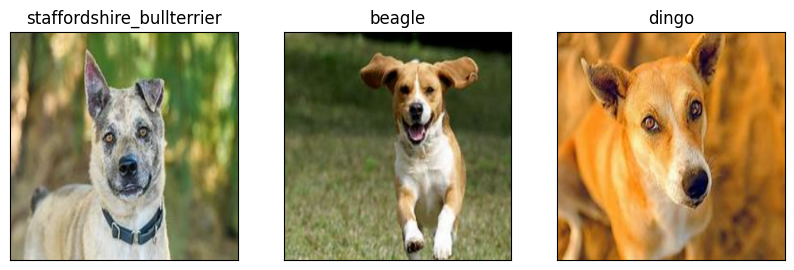

In [299]:
#plot
plt.figure(figsize=(10,10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_labels[i])
  plt.imshow(image)